### **Std ID**: 180041120

### **Name**: Md Farhan Ishmam

In [26]:
from IPython.display import Audio
import librosa
import librosa.display
from scipy.io.wavfile import write
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [27]:
plt.rcParams["figure.figsize"] = (14,10)
plt.rcParams.update({'font.size': 14})

### **Playing an Audio File**

In [28]:
!gdown --id 1wskGKX3pj3E7ET7hjLK2KShVrLhOCbfT

Downloading...
From: https://drive.google.com/uc?id=1wskGKX3pj3E7ET7hjLK2KShVrLhOCbfT
To: /content/07 Tornado of Souls.mp3
100% 12.9M/12.9M [00:00<00:00, 77.4MB/s]


In [29]:
# choose a song of your liking (the more uncommon it is, the better), now play it using IPython.display's Audio Function
Audio('/content/07 Tornado of Souls.mp3')

### **Reading an Audio File into an array**

##### **Sample Rate - The sampling rate refers to the number of samples of audio recorded every second. The most common sample rate for digital audio is 44100 Hertz; this means that the CT sound-wave is sampled 44100 times every second.**

<sup>Source: [A [Mathematical] Analysis of Sample Rates and Audio Quality](https://blogs.umass.edu/Techbytes/2018/04/20/a-mathematical-analysis-of-sample-rates-and-audio-quality/) by Noah Sheridan</sup>

In [85]:
# read your music here # sr is the sample_rate

audio_array,sr = librosa.load('/content/07 Tornado of Souls.mp3') # ignore user warning

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [86]:
# clip the audio_array upto first 90000 samples
audio_array = audio_array[0:90000]

In [87]:
# print the shape of audio_array
audio_array.shape

(90000,)

In [88]:
# print the sampling rate sr
sr

22050

In [89]:
# play the clipped/truncated audio_array using Audio() function
# Audio(audio_array, rate=sampling_rate)

Audio(audio_array, rate=sr)

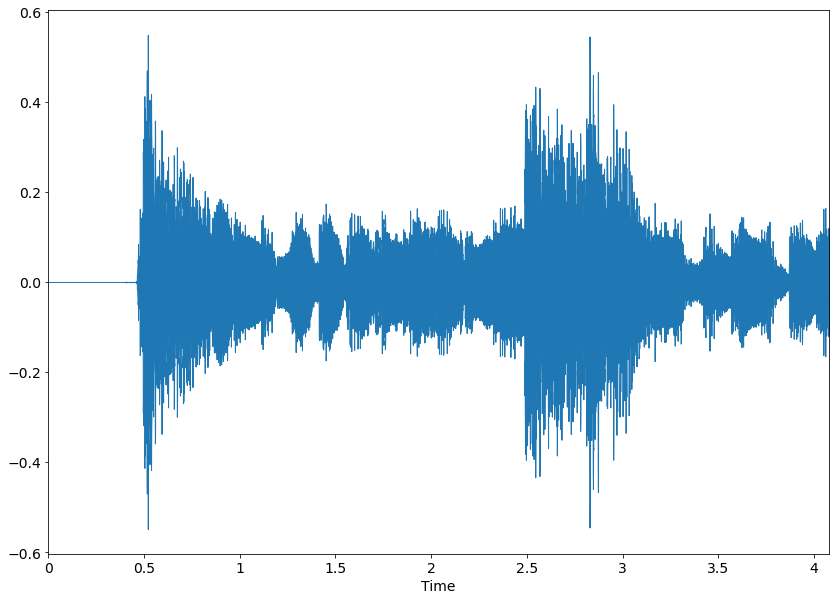

In [90]:
# plot the clipped/truncated audio_array using librosa.display.waveplot() function

librosa.display.waveplot(audio_array, sr=sr);

### **Audio Manipulation**

In [94]:
# In this part, you will implement the moving average filter as shown in the class

# make a function called moving_average( input_signal_I, neighborhood_size_N )
# it will output a signal with equal size of the input signal
# each output_signal sample will contain the average of that corresponding sample value of input signal and (N-1) samples before it.
# for the first N samples you will see that the neighborhood goes beyond the edges of input_signal, then consider those samples to be zero (just as shown in class)
# don't implement it using any fancy automated library function. Just go over the signal and do some arithmatic calculation.

def moving_average(input_signal_I, neighborhood_size_N ):
    filter = np.repeat(1/neighborhood_size_N , neighborhood_size_N)
    f = len(filter)
    orig = np.copy(input_signal_I)
    #Calculate the padding
    # n = length of input signal
    # f = length of filter
    # p = length of padding
    # n + 2p - f + 1 = n
    # => p = (f-1)/2
    
    p = int((f-1)/2)

    #Appending Zeros at the beginning of the array
    padded_orig = np.flip(orig)
    for i in range(p + (f%2==0)): #For filters with even size
      padded_orig = np.append(padded_orig,0)
    padded_orig = np.flip(padded_orig)

    #Flipping the impulse signal
    filter_flip = np.flip(filter)

    output = []
    for i in range(len(padded_orig)-1-(f%2==0)):
      slice_orig = padded_orig[i:i+f]
      slice_filter = filter_flip[:len(slice_orig)]
      val = np.sum(np.multiply(slice_orig, slice_filter))
      output.append(val)
    return np.array(output)

mov_avg_output = moving_average(audio_array,1000)

In [95]:
# listen to the moving average output signal

Audio(mov_avg_output, rate=sr)

In [96]:
# now listen to the original signal again, can you hear any difference?
Audio(audio_array, rate=sr)

**Explain what are the differences that you hear in between these two signals, does it match with the theory that was taught in the class?**


**Ans:** The moving average signal sounds more toned down and it feels like I am hearing the song behind a wall. My assumption is that the moving average signal flattens out the peaks in the original input singal resulting in a toned down or reverbed version of the song.

In [97]:
# now we will implement the moving_avg using convolution. We will use np.convolve
# here, np.ones(w)/w is the kernel of the low pass filter (moving avg. filter)
# passing 'same' in the function means, I want to keep the garbage values (as shown in the class) on the both sides. If I passed 'valid', then it would crop the two sides to discard the garbage values

def moving_average_np_conv(x, w):
    return np.convolve(x, np.ones(w), 'same') / w

mov_avg_conv_output = moving_average_np_conv(audio_array,1000)  
Audio(mov_avg_conv_output, rate=sr)

# **Creating an Audio File**

In [98]:
# first, let's create an audio of about 2 seconds with sample_rate = 22500
# use np.random.uniform to generate an array with (sample_rate*seconds) values. The values should be within -1 to 1, put it in the variable random_audio

sample_rate = 22500
seconds = 2
random_audio = np.random.uniform(-1,1,sample_rate*seconds)
print(random_audio.shape)
# now, let's play that audio
Audio(random_audio, rate=22500)

(45000,)


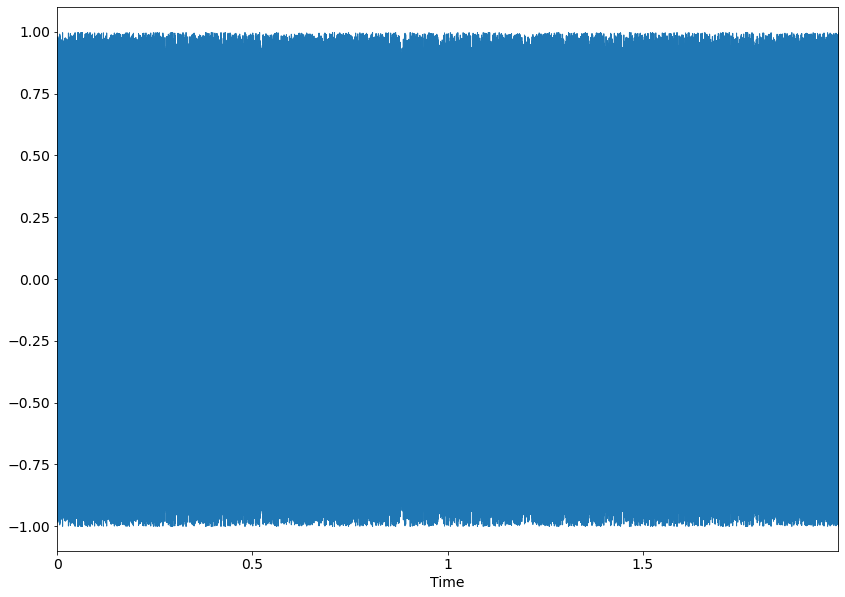

In [99]:
# plot random_audio using librosa waveplot
librosa.display.waveplot(random_audio, sr=sample_rate)

### **Creating audio from General Wave Equations**

In this section, you will actually use the equations taught in the class to generate your own music. In the class, I showed you cosine waves, but sine waves can be used as well. For this task, we will be using sine.

**Wave Function: $f(t) = (A) \ sin(2\pi \ Ft): \text{where $A=$ Amplitude, $F=$frequency, $t$ = time}$**

<sup>Source: [How to Play Music Using Mathematics in Python](https://towardsdatascience.com/mathematics-of-music-in-python-b7d838c84f72) by Nishu Jain</sup>

In [100]:
samplerate = 44100

def get_wave(freq, duration=0.5):
  
    '''
    Function takes the "frequecy" and "time_duration" for a wave 
    as the input and returns a "numpy array" of values at all points 
    in time
    '''
    amplitude = 4096

    # create an array t with values from 0 to duration. as the number of samples will be about (samplerate*duration). The values of t represent time.
    # now calculate wave function f(t) as shown in the text cell above, for each value in the array t
    # in other words, each value in the array t will give you an f(t). then put all the values of f(t) for each t in an array called 'wave'
    
    # this function can be written in two lines using numpy

    t = np.linspace(0, duration, int(samplerate*duration))
    wave = amplitude*np.sin(2*np.pi*freq*t)

    return wave

In [101]:
# now test your function get_wave()
# play it in low volume, some of the wave might be a little harsh to hear
# put these values in frequency [100, 500, 1500]
frequency = 1500 # change this frequency value and observe the effect
test_audio = get_wave(frequency, duration = 1.5)
Audio(test_audio, rate = samplerate)

**Explain what are the differences that you hear in between the audios for different frequency values**


**Ans:** The audio with 100 frequency sounded lower and deeper. The audio with frequency was more shrill and high-pitched. The audio with 1500 frequency was really shrill as if it was piercing the ears.

In [102]:
# read the given excel file using pandas
df = pd.read_excel('/content/note_frequencies.xlsx')

<sup>Source Data: [Frequencies for equal-tempered scale](https://pages.mtu.edu/~suits/notefreqs.html) by  Bryan H. Suits</sup>

In [44]:
# this excel files contains the chords and their corresponding frequencies
df

,Note,Frequency (Hz),Wavelength (cm)
0,C0,16.35,2109.89
1,C#0,17.32,1991.47
2,D0,18.35,1879.69
3,D#0,19.45,1774.20
4,E0,20.60,1674.62
...,...,...,...
103,G8,6271.93,5.50
104,G#8,6644.88,5.19
105,A8,7040.00,4.90
106,A#8,7458.62,4.63


In [ ]:
# So, If you know chords of a certain song, then you can find out the frequencies 
# from the frequencies, you can generate short audio signals using get_wave() function, then merging/concatenating the audio signal for different chords, you can create the whole song

In [103]:
def get_piano_notes():
    '''
    Returns a dict object for all the piano 
    note's frequencies
    '''
    octave = df['Note'].to_list()
    freq = df['Frequency (Hz)'].to_list()
    
    note_freqs = {note:sound for note,sound in zip(octave,freq)}
    note_freqs[''] = 0.0
    
    return note_freqs
  
note_freqs = get_piano_notes()

In [104]:
def get_song_wave(music_notes):
    '''
    Function to concatenate all the waves (notes)
    '''
    note_freqs = get_piano_notes() 
    song = [get_wave(note_freqs[note], duration=0.4) for note in music_notes.split('-')]
    song = np.concatenate(song)
    return song

music_notes = 'F#3-F#4-A#4-C#5-D#5-F#5-F#4-C#5-G#4-F#4-F4-F#4-F#3-F#4-A#4-C#5-D#5-F#5-F#4-C#5-G#4-F#4-F4-F#4-D#3-F#4-A#4-C#5-D#5-F#5-F#4-C#5-G#4-F#4-F4-F#4'
music = get_song_wave(music_notes)
music = music * (16300/np.max(music)) 

Audio(music, rate=samplerate)
# changing the 'duration', you can the speed of the music
# changing the music_notes, you can create audios for different songs
# this particular chords/song is from Avicii's Fade into the darkness

In [105]:
# now choose a song of your liking (the more uncommon the song is, the better)
# find out its chords, the write the chords in the array 'music_notes'

#I'm trying to recreate the song Seven Nation Army by The White Stripes
#https://www.youtube.com/watch?v=0J2QdDbelmY

music_notes = 'E2-E2-G3-E2-D3-C1-B1-B1-E2-E2-G3-E2-D3-C1-D3-C1-B1-B1-E2-E2-G3-E2-D3-C1-B1-B1-E2-E2-G3-E2-D3-C1-D3-C1-B1-B1'
my_music = get_song_wave(music_notes)
my_music = my_music * (16300/np.max(my_music)) 
Audio(my_music, rate=samplerate)

<sup>Help: [How to Play Music Using Mathematics in Python](https://towardsdatascience.com/mathematics-of-music-in-python-b7d838c84f72) by Nishu Jain</sup>

In [106]:
# save your music as a .wav file
write('my_music.wav', samplerate, my_music.astype(np.int16))

In [107]:
# play the saved music
Audio('/content/my_music.wav')

### **References and Additional Learning**

#### **Article**

- **[Analysis of Sample Rates and Audio Quality](https://blogs.umass.edu/Techbytes/2018/04/20/a-mathematical-analysis-of-sample-rates-and-audio-quality/) by Noah Sheridan**

- **[How to Play Music Using Mathematics in Python](https://towardsdatascience.com/mathematics-of-music-in-python-b7d838c84f72) by Nishu Jain</sup>**

#### **Frequency Data**

- **[Frequencies for equal-tempered scale](https://pages.mtu.edu/~suits/notefreqs.html) by  Bryan H. Suits**

#### **Video**

- **[Mathematics of Music](https://www.youtube.com/channel/UC5G6pckR64hW9GOgo_R7bpg/about) by Nishu Jain** 

#### **Websites**

- **[Jupyter Audio Basics from Notes on Music Information Retrieval](https://musicinformationretrieval.com/ipython_audio.html)**

- **[librosa documentation](https://librosa.org/doc/latest/index.html)**

- **[Module display for IPython](https://ipython.org/ipython-doc/3/api/generated/IPython.display.html)**

#### **Connect**

- **Feel free to connect with Adrian on [YouTube](https://www.youtube.com/channel/UCPuDxI3xb_ryUUMfkm0jsRA), [LinkedIn](https://www.linkedin.com/in/adrian-dolinay-frm-96a289106/), [Twitter](https://twitter.com/DolinayG) and [GitHub](https://github.com/ad17171717). Happy coding!**